In [2]:
import matplotlib.pyplot as plt
import geopandas as gpd
import pydeck as pdk
import rasterio
import numpy as np
import pyproj

print(pyproj.datadir.get_data_dir())

%matplotlib inline

/usr/local/Caskroom/miniconda/base/share/proj


To determine what part to get, we use the figure from [mines](https://eogdata.mines.edu/products/vnl/#monthly),

![coverage](https://eogdata.mines.edu/products/assets/img/tile_map.png)

As can be seen in the file [download directory](https://eogdata.mines.edu/nighttime_light/monthly/v10/2021/202109/vcmcfg/) the latitude and longtitude is switched around in some cases.

In [3]:
from pyalanysis.data import ViirsDnbMonthlyDataLoader, ViirsDnbMonthlyType

vdl = ViirsDnbMonthlyDataLoader()

viirs = vdl.open_viirs_monthly_file(
    vdl.get_viirs_dnb_monthly_file(
        "75N060W", 2021, 12, ViirsDnbMonthlyType.STRAY_LIGHT_CORRECTED
    )
)

In [4]:
# An explicit check to ensure that we have the right projection
# to allow to clip the Netherlands

if viirs.rio.crs is None:
    viirs.rio.set_crs(rasterio.crs.CRS({"init": "EPSG:4326"}))

viirs

<xarray.Dataset>
Dimensions:      (band: 1, x: 28800, y: 18000, time: 1)
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 -60.0 -60.0 -59.99 -59.99 ... 59.99 59.99 60.0
  * y            (y) float64 75.0 75.0 74.99 74.99 ... 0.0125 0.008333 0.004166
    spatial_ref  int64 0
  * time         (time) datetime64[ns] 2021-12-01
Data variables:
    avg_rad9h    (time, band, y, x) float32 0.49 0.5 0.49 ... 0.25 0.23 0.28
    cvg          (time, band, y, x) uint16 73 73 73 73 73 73 ... 16 16 16 16 16
    cf_cvg       (time, band, y, x) uint16 27 25 25 25 25 24 23 ... 6 6 6 6 6 5
Attributes:
    scale_factor:  1.0
    add_offset:    0.0

In [5]:
import tempfile
import requests
import os

source_url = (
    "https://naturalearth.s3.amazonaws.com/"
    + "10m_cultural/ne_10m_admin_0_countries.zip"
)
dst_fn = "ne_10m_admin_0_countries.zip"


def download_file(url: str, dest_filename: str) -> str:
    req = requests.get(url)
    file = open(dest_filename, "wb")
    for chunk in req.iter_content(100000):
        file.write(chunk)
    file.close()

    return dest_filename


zip_fp = download_file(source_url, os.path.join(tempfile.mkdtemp(), dst_fn))

ctys = gpd.read_file("zip://" + zip_fp + "!ne_10m_admin_0_countries.shp")

In [6]:
nl = ctys[ctys.ISO_A2 == "NL"]
nl

,featurecla,scalerank,LABELRANK,SOVEREIGNT,SOV_A3,ADM0_DIF,LEVEL,TYPE,TLC,ADMIN,...,FCLASS_TR,FCLASS_ID,FCLASS_PL,FCLASS_GR,FCLASS_IT,FCLASS_NL,FCLASS_SE,FCLASS_BD,FCLASS_UA,geometry
93,Admin-0 country,0,5,Netherlands,NL1,1,2,Country,1,Netherlands,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((7.19459 53.24502, 7.19747 53.2..."


In [14]:
nl.reset_index()["geometry"].to_json()

'{"type": "FeatureCollection", "features": [{"id": "0", "type": "Feature", "properties": {}, "geometry": {"type": "MultiPolygon", "coordinates": [[[[7.194590691000087, 53.245021877000056], [7.19747237100006, 53.2166236370001], [7.198505900000043, 53.20057810500005], [7.195405314000112, 53.18499766100011], [7.18858402500004, 53.16778940800002], [7.174424682000108, 53.14577524900004], [7.171944214000121, 53.13771372500007], [7.172667684000118, 53.12575063100009], [7.176491740000074, 53.11939443000007], [7.181349324000081, 53.11417511100005], [7.18507002700008, 53.10544179300008], [7.194371786000119, 53.03384409600004], [7.19282149300011, 52.998006490000094], [7.183623088000104, 52.966122131000034], [7.161918986000103, 52.93263580400013], [7.079856812000116, 52.854423522999994], [7.072150759000124, 52.841316552000066], [7.061976766000043, 52.824011942000126], [7.053295125000091, 52.79057729100005], [7.04399336700007, 52.682625224000006], [7.036655314000058, 52.647381897000045], [7.0184652

In [6]:
netherlands = [
    {
        "type": "Polygon",
        "coordinates": [
            [
                [3.2006621064250274, 53.58584446228139],
                [3.2006621064250274, 50.69456930499138],
                [7.276589840800027, 50.69456930499138],
                [7.276589840800027, 53.58584446228139],
            ]
        ],
    }
]

In [7]:
alan_nl = viirs[dict(band=0, time=0)].rio.clip(netherlands, crs=4326)
alan_nl

<xarray.Dataset>
Dimensions:      (y: 694, x: 978)
Coordinates:
  * y            (y) float64 53.58 53.58 53.57 53.57 ... 50.71 50.7 50.7 50.7
  * x            (x) float64 3.204 3.208 3.213 3.217 ... 7.263 7.267 7.271 7.275
    band         int64 1
    time         datetime64[ns] 2021-12-01
    spatial_ref  int64 0
Data variables:
    avg_rad9h    (y, x) float32 0.25 0.24 0.13 0.21 0.15 ... 1.89 2.28 2.25 3.37
    cvg          (y, x) uint16 30 30 30 30 30 30 30 30 ... 26 26 26 26 26 26 26
    cf_cvg       (y, x) uint16 4 6 6 4 4 5 5 5 5 5 5 4 ... 4 4 4 3 4 4 4 5 4 4 4
Attributes:
    scale_factor:  1.0
    add_offset:    0.0

In [8]:
alan_nl.rio.crs.to_string()

'EPSG:4326'

In [9]:
alan_nl_df = (
    alan_nl.drop_vars(["spatial_ref", "band", "time"]).to_dataframe().reset_index()
)

In [10]:
alan_nl_gdf = gpd.GeoDataFrame(
    alan_nl_df,
    geometry=gpd.points_from_xy(alan_nl_df.x, alan_nl_df.y),
    crs=alan_nl.rio.crs.to_string(),
)
alan_nl_gdf = alan_nl_gdf.drop(["y", "x"], axis=1)

assert alan_nl_gdf.crs == pyproj.CRS.from_authority("EPSG", "4326")

print(alan_nl_gdf.describe())

           avg_rad9h            cvg         cf_cvg
count  678732.000000  678732.000000  678732.000000
mean        3.866193      27.221435       5.278151
std        42.415092       1.005175       2.639178
min        -0.560000      24.000000       0.000000
25%         0.340000      26.000000       3.000000
50%         0.940000      27.000000       5.000000
75%         2.600000      28.000000       7.000000
max     11276.230469      30.000000      16.000000


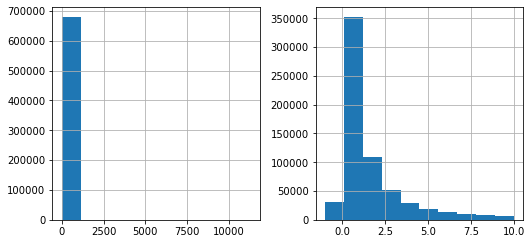

In [11]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

fig, axes = plt.subplots(1, 2)

alan_nl_gdf["avg_rad9h"].hist(ax=axes[0])
alan_nl_gdf["avg_rad9h"].hist(range=(-1, 10), ax=axes[1]);

In [12]:
np.sum(alan_nl_gdf["avg_rad9h"] < 1)

348921

In [13]:
alan_nl_gdf.drop(alan_nl_gdf.index[alan_nl_gdf["avg_rad9h"] < 1], inplace=True)

In [14]:
print(f"Shape before clipping: {alan_nl_gdf.shape}")
alan_nl_gdf = alan_nl_gdf.clip(nl)
print(f"Shape after clipping: {alan_nl_gdf.shape}")

Shape before clipping: (329811, 4)
Shape after clipping: (163509, 4)


In [16]:
def standardize(array: np.array) -> np.array:
    scale = abs(np.max(array) - np.min(array))
    return (array - np.min(array)) / scale

In [17]:
df = alan_nl_gdf.h3.geo_to_h3_aggregate(8, "mean")
df

,avg_rad9h,cvg,cf_cvg,geometry
h3_08,,,,
88194d801bfffff,1.323333,27.0,7.666667,"POLYGON ((3.59327 51.29713, 3.58674 51.29616, ..."
88194d8059fffff,1.626667,27.0,5.000000,"POLYGON ((3.60205 51.32332, 3.59552 51.32235, ..."
88194d8101fffff,1.776667,28.0,8.000000,"POLYGON ((3.48161 51.33436, 3.47508 51.33338, ..."
88194d8103fffff,3.975000,28.0,7.166667,"POLYGON ((3.48524 51.32661, 3.47870 51.32563, ..."
88194d8107fffff,1.810000,28.0,7.000000,"POLYGON ((3.47362 51.32901, 3.46708 51.32803, ..."
...,...,...,...,...
881fa5db65fffff,9.977500,27.0,5.750000,"POLYGON ((5.38979 51.42410, 5.38819 51.41975, ..."
881fa5db67fffff,14.096666,27.0,5.333333,"POLYGON ((5.40206 51.42324, 5.40046 51.41889, ..."
881fa5db69fffff,15.946000,27.0,3.600000,"POLYGON ((5.39458 51.43715, 5.39298 51.43280, ..."


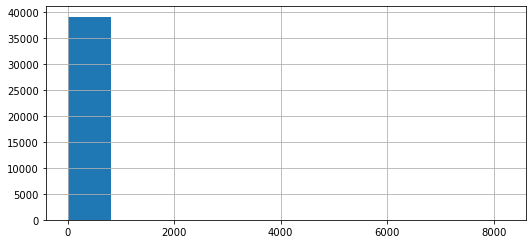

In [18]:
df["log_avg_rad9h"] = np.log(df["avg_rad9h"])
df["avg_rad9h"].hist();

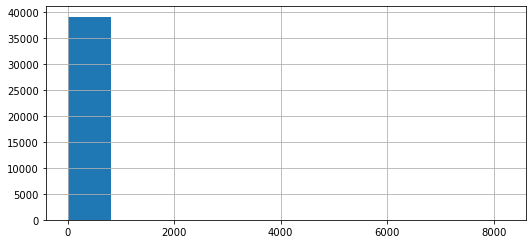

In [19]:
df = df.drop(df.index[df["avg_rad9h"] < 1])
df["avg_rad9h"].hist();

In [20]:
df = df.reset_index(0)

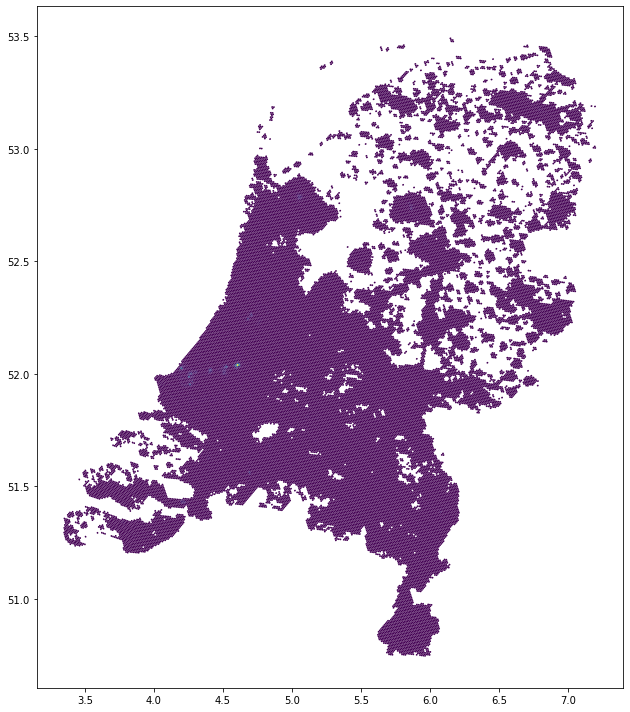

In [21]:
df.plot(column="avg_rad9h", figsize=(10, 10));

In [22]:
netherlands[0]["coordinates"]

[[[3.2006621064250274, 53.58584446228139],
  [3.2006621064250274, 50.69456930499138],
  [7.276589840800027, 50.69456930499138],
  [7.276589840800027, 53.58584446228139]]]

In [23]:
COLOR_RANGE = [
    [20, 57, 78],
    [65, 182, 196],
    [199, 233, 180],
    [237, 248, 177],
    [255, 255, 204],
    [255, 237, 160],
    [254, 217, 118],
    [254, 178, 76],
    [253, 141, 60],
    [252, 78, 42],
    [227, 26, 28],
    [189, 0, 38],
    [128, 0, 38],
]

BREAKS = np.power(10, np.linspace(0, 4, len(COLOR_RANGE)))


def color_scale(val):
    for i, b in enumerate(BREAKS):
        if val < b:
            return COLOR_RANGE[i]
    return COLOR_RANGE[i]

In [24]:
df["fill_color"] = df["avg_rad9h"].apply(lambda x: color_scale(x))

In [25]:
import json

In [26]:
df_json = json.loads(
    df[["log_avg_rad9h", "geometry", "fill_color", "avg_rad9h"]].to_json()
)

layer = pdk.Layer(
    "GeoJsonLayer",
    data=df_json,
    get_position="geometry.coordinates",
    opacity=0.2,
    stroked=True,
    filled=True,
    pickable=True,
    fp64=True,
    extruded=True,
    wireframe=True,
    get_elevation="properties.avg_rad9h * 20",
    get_fill_color="properties.fill_color",
    get_line_color=[255, 255, 255],
)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=4.834,
    latitude=52.355,
    zoom=7,
    min_zoom=5,
    max_zoom=15,
    pitch=40.5,
    bearing=0,
)

geojson_tooltip = {
    "html": """
      <b>Average radiance:</b> {properties.avg_rad9h}<br>
    """,
    "style": {"backgroundColor": "steelblue", "color": "white"},
}

tooltip = {
    "geojson": geojson_tooltip,
    "landcover": {
        "html": "The background",
        "style": {"backgroundColor": "red", "color": "white"},
    },
}

# Combined all of it and render a viewport
r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip=tooltip)
r.to_html("alan-nl-example-3d.html")

In [27]:
layer = pdk.Layer(
    "GeoJsonLayer",
    data=df_json,
    get_position="geometry.coordinates",
    opacity=0.2,
    stroked=True,
    filled=True,
    pickable=True,
    fp64=True,
    extruded=False,
    wireframe=False,
    get_fill_color="properties.fill_color",
    get_line_color=[255, 255, 255],
)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=4.834,
    latitude=52.355,
    zoom=7,
    min_zoom=5,
    max_zoom=15,
    pitch=0,
    bearing=0,
)

geojson_tooltip = {
    "html": """
      <b>Average radiance:</b> {properties.avg_rad9h}<br>
    """,
    "style": {"backgroundColor": "steelblue", "color": "white"},
}

tooltip = {
    "geojson": geojson_tooltip,
    "landcover": {
        "html": "The background",
        "style": {"backgroundColor": "red", "color": "white"},
    },
}

# Combined all of it and render a viewport
r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip=tooltip)
r.to_html("alan-nl-example-flat.html")

In [28]:
df_plot = df[["avg_rad9h", "cvg", "cf_cvg", "log_avg_rad9h", "geometry"]]
type(df_plot.geometry[0])

shapely.geometry.polygon.Polygon

In [29]:
import keplergl

In [30]:
nl_config = {
    "version": "v1",
    "config": {
        "visState": {
            "filters": [],
            "layers": [
                {
                    "id": "jarw77",
                    "type": "geojson",
                    "config": {
                        "dataId": "ALAN",
                        "label": "ALAN",
                        "color": [255, 153, 31],
                        "highlightColor": [252, 242, 26, 255],
                        "columns": {"geojson": "geometry"},
                        "isVisible": True,
                        "visConfig": {
                            "opacity": 0.8,
                            "strokeOpacity": 0.8,
                            "thickness": 0.5,
                            "strokeColor": [241, 92, 23],
                            "colorRange": {
                                "name": "UberPool",
                                "type": "diverging",
                                "category": "Uber",
                                "colors": [
                                    "#223F9A",
                                    "#2C51BE",
                                    "#482BBD",
                                    "#7A0DA6",
                                    "#AE0E7F",
                                    "#CF1750",
                                    "#E31A1A",
                                    "#FD7900",
                                    "#FAC200",
                                    "#FAE300",
                                ],
                            },
                            "strokeColorRange": {
                                "name": "Global Warming",
                                "type": "sequential",
                                "category": "Uber",
                                "colors": [
                                    "#5A1846",
                                    "#900C3F",
                                    "#C70039",
                                    "#E3611C",
                                    "#F1920E",
                                    "#FFC300",
                                ],
                            },
                            "radius": 10,
                            "sizeRange": [0, 10],
                            "radiusRange": [0, 50],
                            "heightRange": [0, 500],
                            "elevationScale": 20,
                            "enableElevationZoomFactor": True,
                            "stroked": False,
                            "filled": True,
                            "enable3d": True,
                            "wireframe": True,
                        },
                        "hidden": False,
                        "textLabel": [
                            {
                                "field": None,
                                "color": [255, 255, 255],
                                "size": 18,
                                "offset": [0, 0],
                                "anchor": "start",
                                "alignment": "center",
                            }
                        ],
                    },
                    "visualChannels": {
                        "colorField": {"name": "log_avg_rad9h", "type": "real"},
                        "colorScale": "linear",
                        "strokeColorField": None,
                        "strokeColorScale": "quantile",
                        "sizeField": None,
                        "sizeScale": "linear",
                        "heightField": {"name": "avg_rad9h", "type": "real"},
                        "heightScale": "linear",
                        "radiusField": None,
                        "radiusScale": "linear",
                    },
                }
            ],
            "interactionConfig": {
                "tooltip": {
                    "fieldsToShow": {
                        "ALAN": [
                            {"name": "avg_rad9h", "format": None},
                            {"name": "cvg", "format": None},
                            {"name": "cf_cvg", "format": None},
                        ]
                    },
                    "compareMode": False,
                    "compareType": "absolute",
                    "enabled": True,
                },
                "brush": {"size": 0.5, "enabled": False},
                "geocoder": {"enabled": False},
                "coordinate": {"enabled": False},
            },
            "layerBlending": "normal",
            "splitMaps": [],
            "animationConfig": {"currentTime": None, "speed": 1},
        },
        "mapState": {
            "bearing": 1.8942578613830534,
            "dragRotate": True,
            "latitude": 51.953360171697035,
            "longitude": 5.0814788051229725,
            "pitch": 47.477278890828785,
            "zoom": 7.817288835959892,
            "isSplit": False,
        },
        "mapStyle": {
            "styleType": "dark",
            "topLayerGroups": {},
            "visibleLayerGroups": {
                "label": True,
                "road": True,
                "border": False,
                "building": True,
                "water": True,
                "land": True,
                "3d building": True,
            },
            "threeDBuildingColor": [166, 165, 165],
            "mapStyles": {},
        },
    },
}

In [31]:
map_1 = keplergl.KeplerGl(height=800, config=nl_config)
map_1.add_data(data=df_plot, name="ALAN")
map_1

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'jarw77', 'type': '…

In [32]:
map_1.save_to_html(file_name="keplergl.html", read_only=True)

Map saved to keplergl.html!
